Running HillVallEA on the defined objective function
8


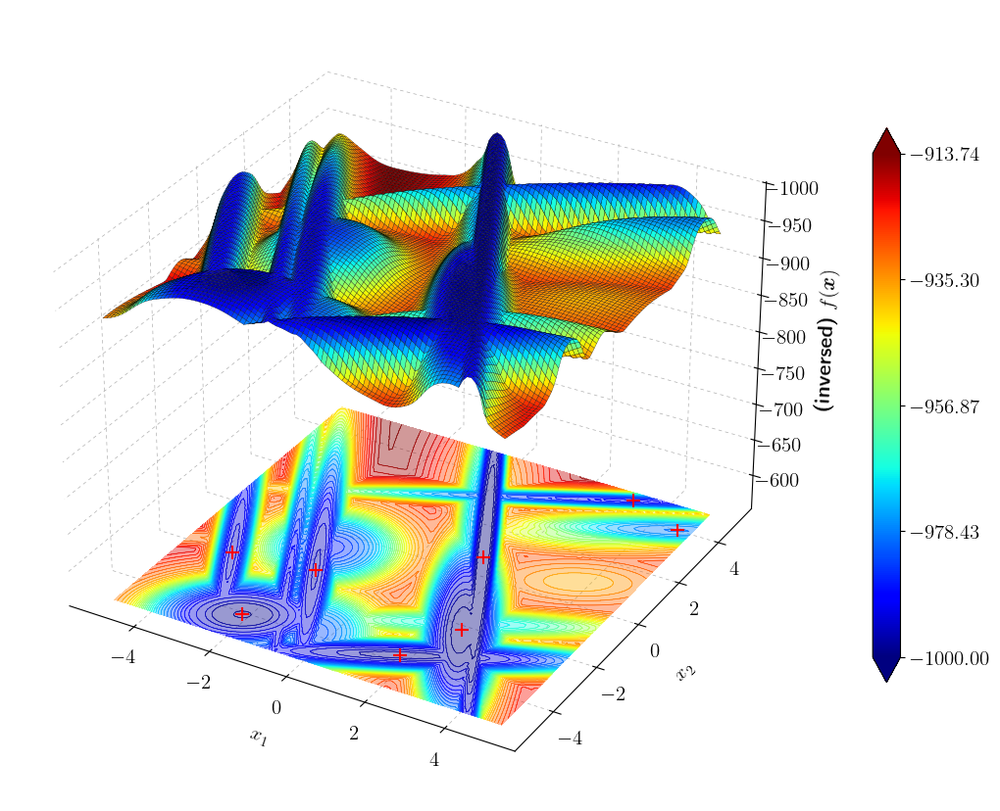

In [1]:
import numpy as np
from ioh import ProblemClass, get_problem

import FewShotCVRP.utils.plots as myplots
from hillvallimpl import HillVallEAConfiguration, optimize

f = get_problem(22, instance=1, dimension=2, problem_class=ProblemClass.BBOB)

dim = 2
lower = [-5] * dim
upper = [5] * dim
config = HillVallEAConfiguration(
    f,
    dim,
    10000,
    10**9,
    # internal_optimizer_name="CMSA-ES",
    lower=lower,
    upper=upper,
    random_seed=42,
    TargetTolFun=100.0,
)

archive = optimize(config)
print(len(archive))

myplots.good_plt_config()
fig, ax = myplots.plot_3D_surface(
    (-5, 5),
    (-5, 5),
    f,
    np.array(archive),
    is_axis_names=True,
    is_white_facecolor=True,
    is_colorbar=True,
    discretization=100,
    zfactor=2.0,
    is_inverse=True,
)

### Application of HillVallEA to optimizatin EI

In [8]:
import numpy as np
from ioh import ProblemClass, get_problem
from scipy.stats import norm

import FewShotCVRP.bo_pure as bo_pure
import FewShotCVRP.utils.plots as myplots
from hillvallimpl import HillVallEAConfiguration, optimize

snap = bo_pure.BayesianOptimizer.load_snapshot("./gp-iter-20")


def EI(gp_, xi, y_, X) -> np.ndarray:
    X = bo_pure._to_2d(np.asarray(X, dtype=float))
    mu, sigma = gp_.predict(X, return_std=True)
    sigma = np.maximum(sigma, 1e-12)

    y_best = np.min(y_)
    improv = y_best - mu - xi

    Z = improv / sigma
    ei = improv * norm.cdf(Z) + sigma * norm.pdf(Z)
    ei = np.where(sigma <= 1e-12, 0.0, ei)
    return ei


gp_ = snap.gp
y_ = np.array(snap.arrays["y_"])
bo_ei = lambda x: EI(gp_, 0.01, y_, x)[0]

bounds = snap.arrays["bounds"]
config = HillVallEAConfiguration(
    lambda x: -bo_ei(x),
    bounds.shape[0],
    5000 * bounds.shape[0],
    10**9,
    # internal_optimizer_name="CMSA-ES",
    lower=bounds[:, 0],
    upper=bounds[:, 1],
    random_seed=42,
    TargetTolFun=100.0,
)

archive = optimize(config)
print(len(archive))

Running HillVallEA on the defined objective function
25


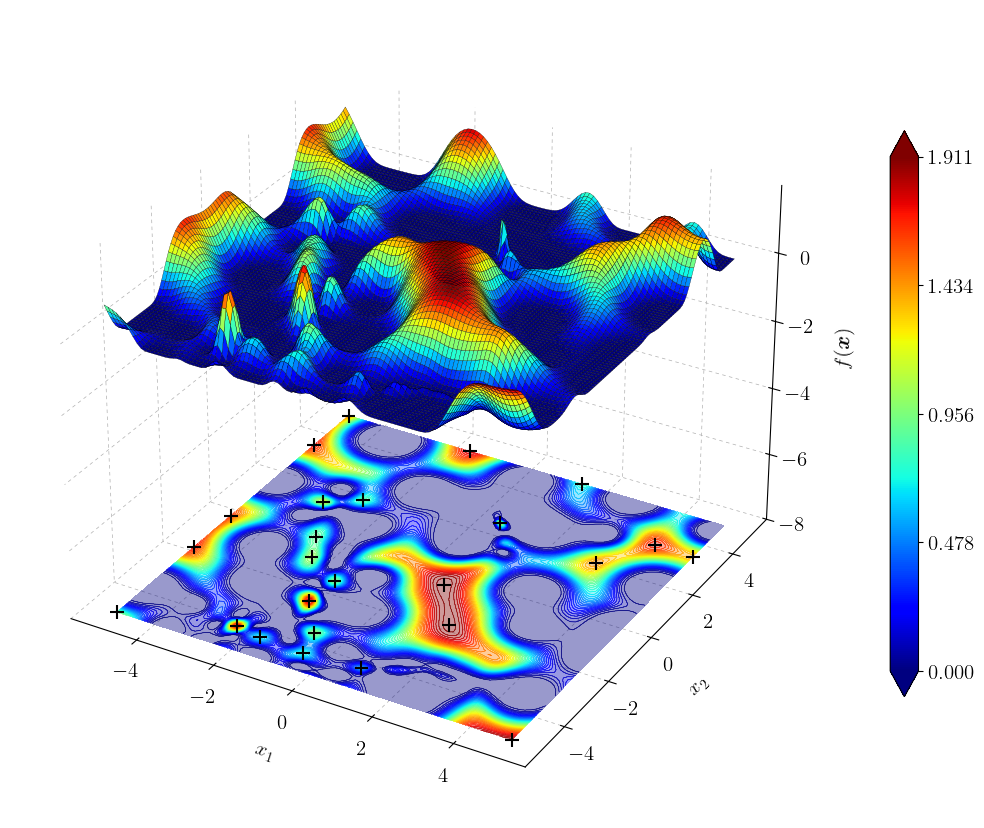

In [33]:
from importlib import reload

reload(myplots)

myplots.good_plt_config()
fig, ax = myplots.plot_3D_surface(
    (-5, 5),
    (-5, 5),
    bo_ei,
    np.array(archive),
    is_axis_names=True,
    is_white_facecolor=True,
    is_colorbar=True,
    discretization=100,
    zfactor=2.0,
    is_inverse=False,
    scatter_search_space_color="black",
)

### Optimization of AF function in BO

Selected 1 new points
Selected 3 new points
Selected 2 new points
Selected 2 new points
Selected 2 new points
Selected 1 new points
Selected 1 new points
Selected 3 new points
Selected 3 new points
Selected 2 new points


/datanaco/antonovk/FewShotCVRP/FewShotCVRP/utils/plots.py:221: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(subplot_kw={"projection": "3d", "computed_zorder": False})


Selected 1 new points
Selected 3 new points
Selected 5 new points
Selected 3 new points
Selected 1 new points
Selected 2 new points
Selected 4 new points
Selected 6 new points
Selected 3 new points
Selected 2 new points
Best x: [0.34947514 2.62437346] Best y: -999.5413388822478
Recommended x: [-2.37908101 -4.14372014] Best y: [-2.37908101 -4.14372014]
Kernel: 1.05**2 * RBF(length_scale=0.673)

ARD report:
feature    length_scale        1/length
---------------------------------------
x0             0.672634         1.48669
x1             0.672634         1.48669


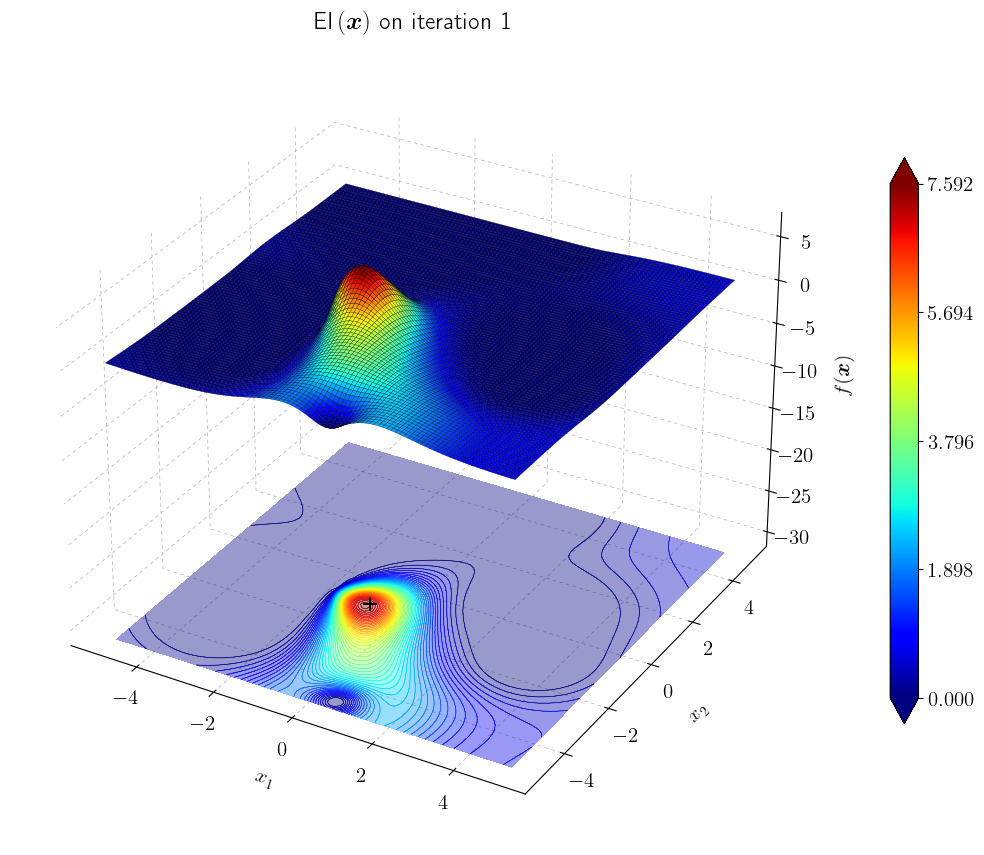

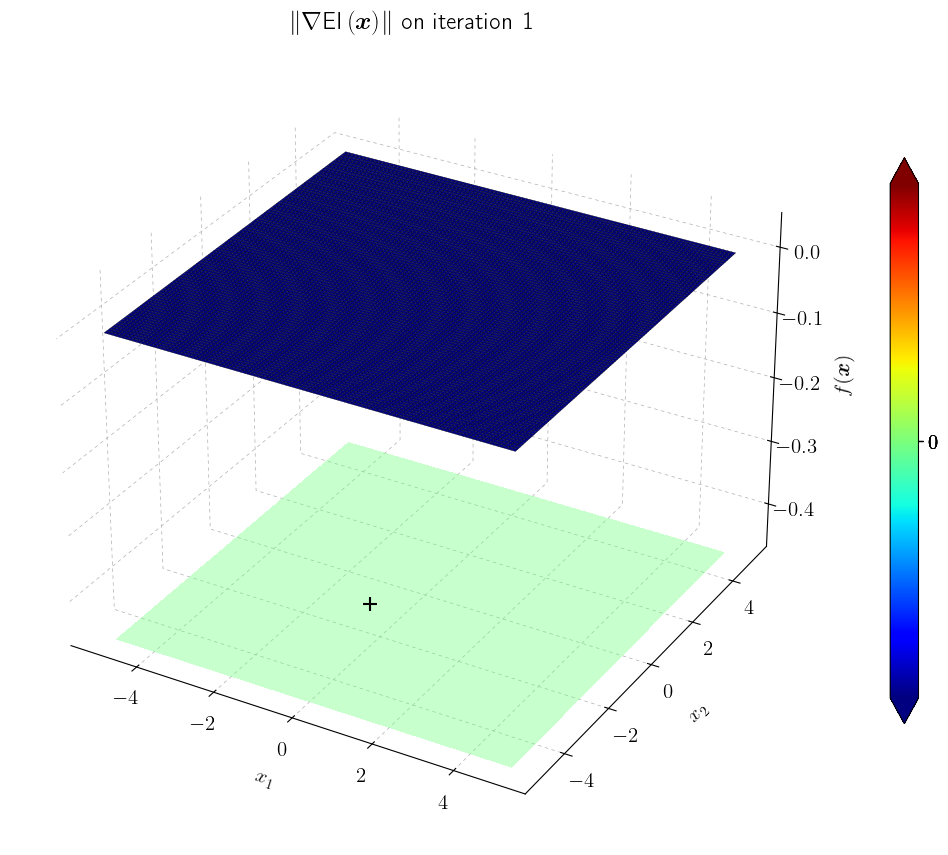

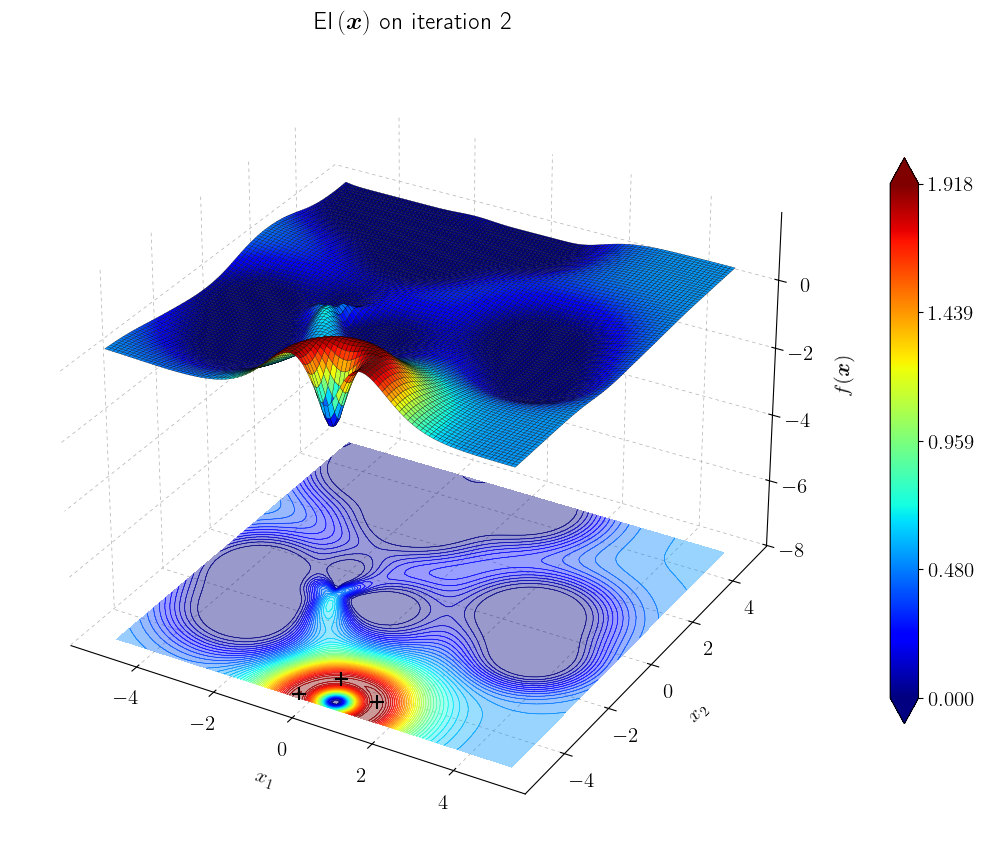

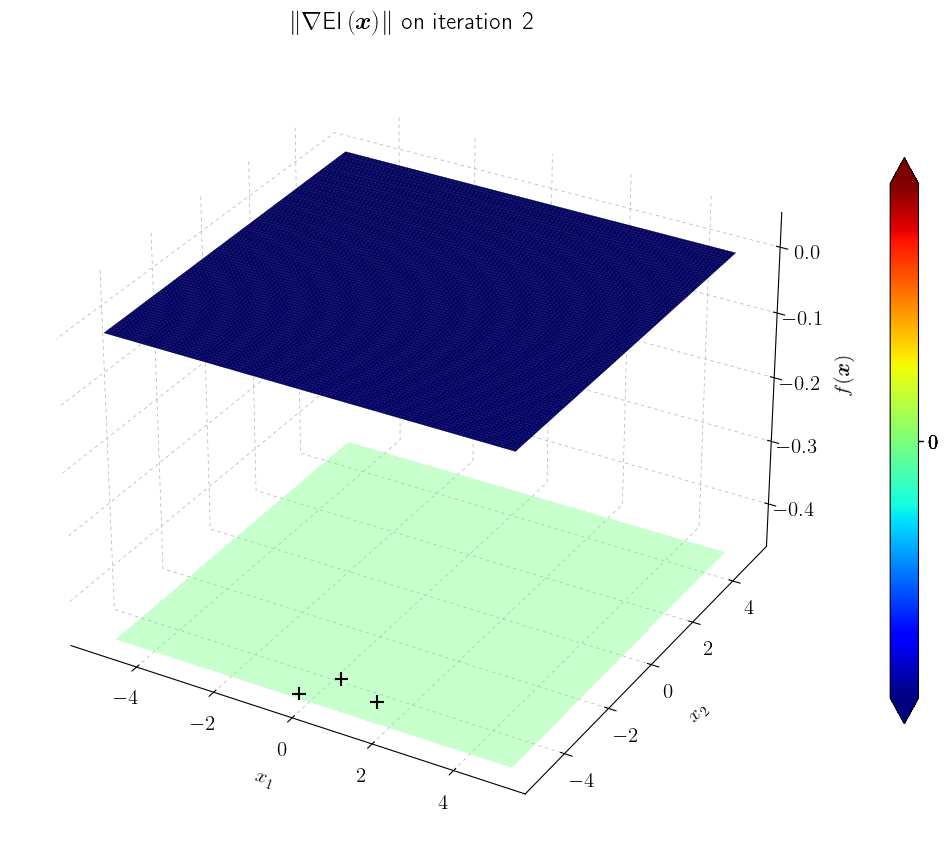

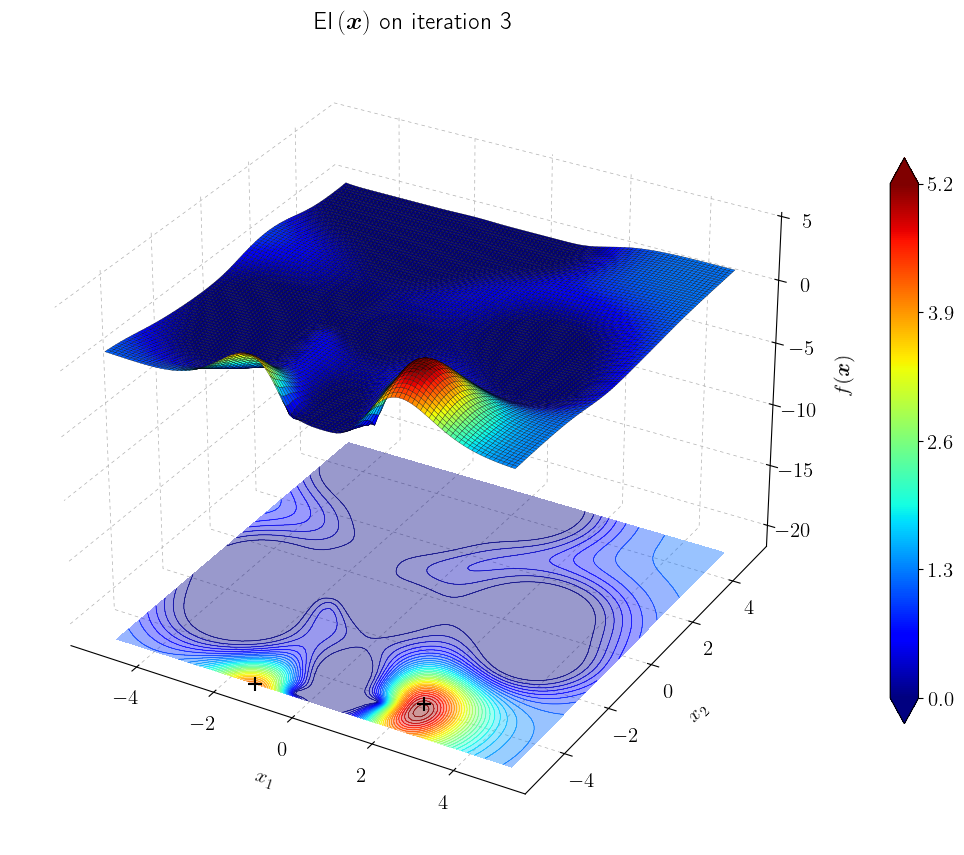

...

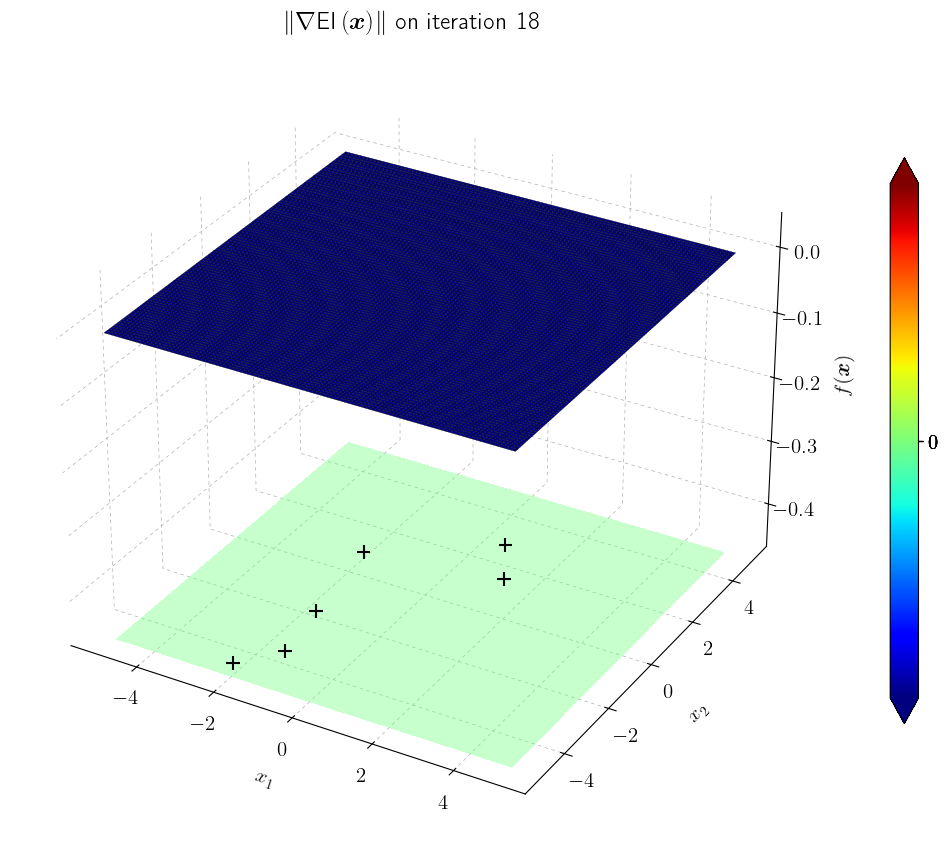

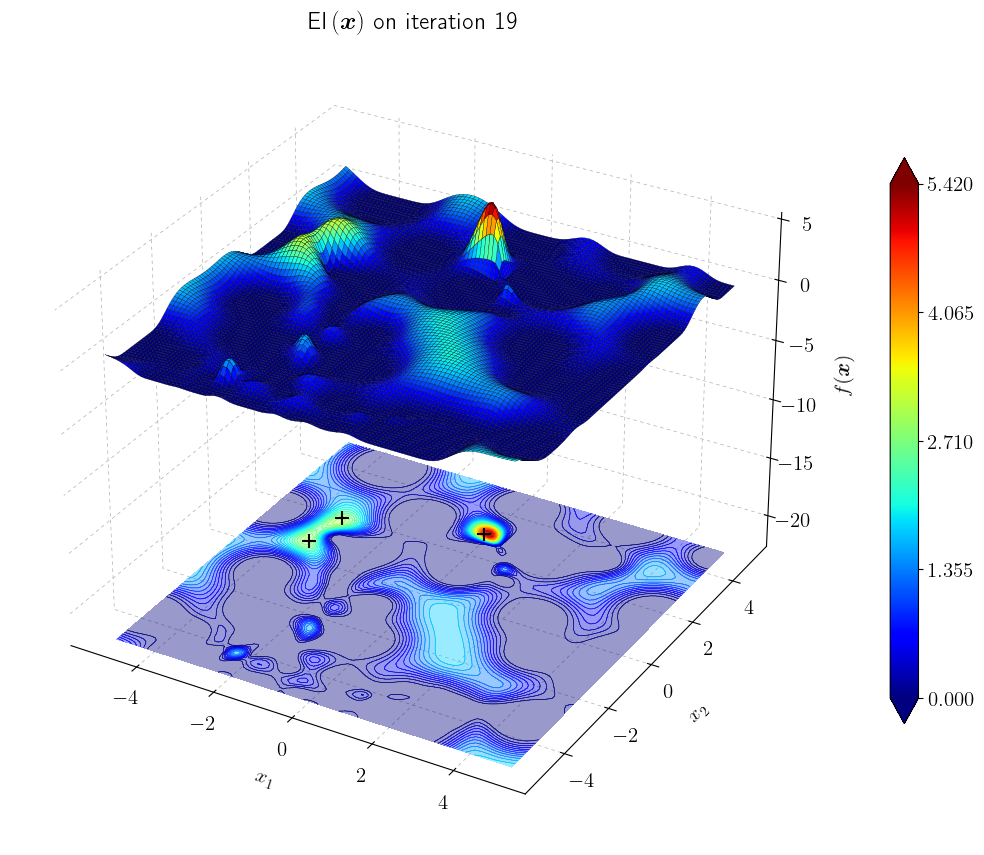

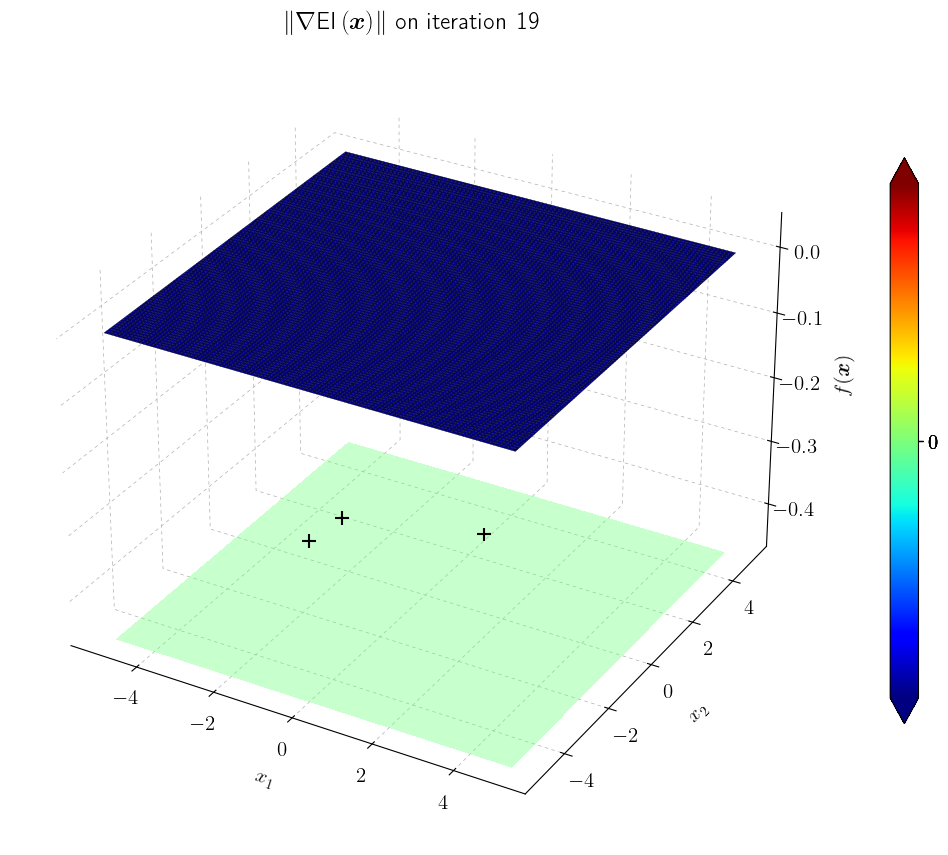

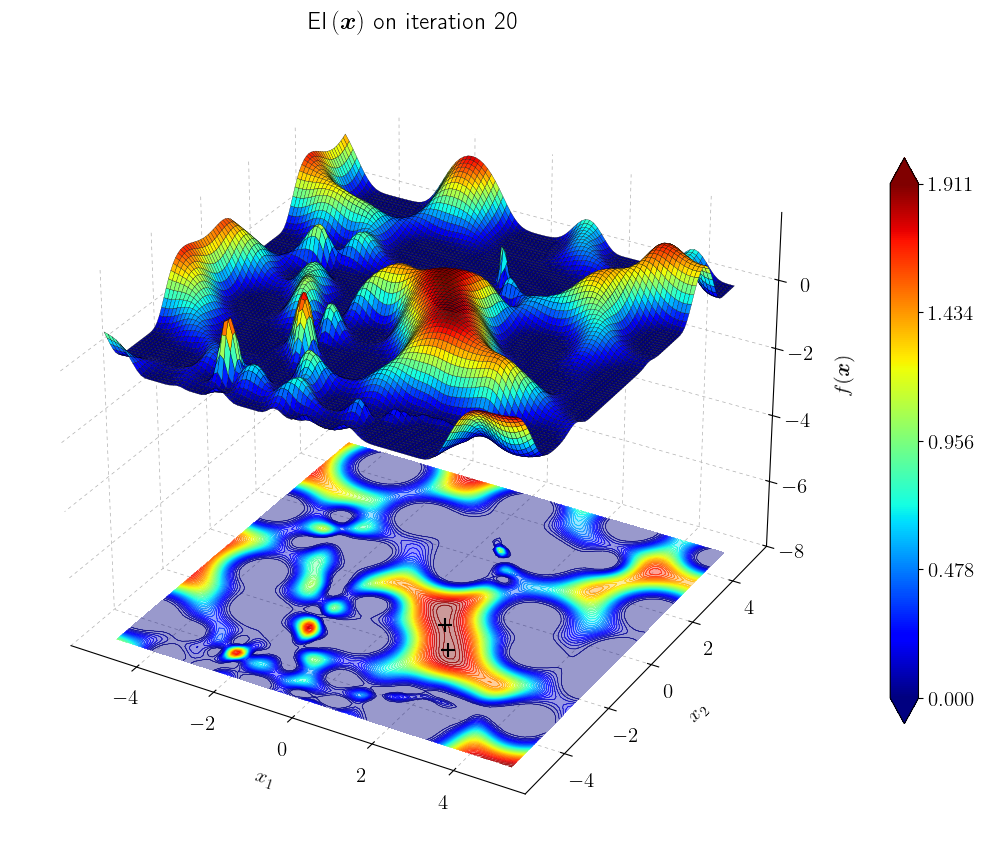

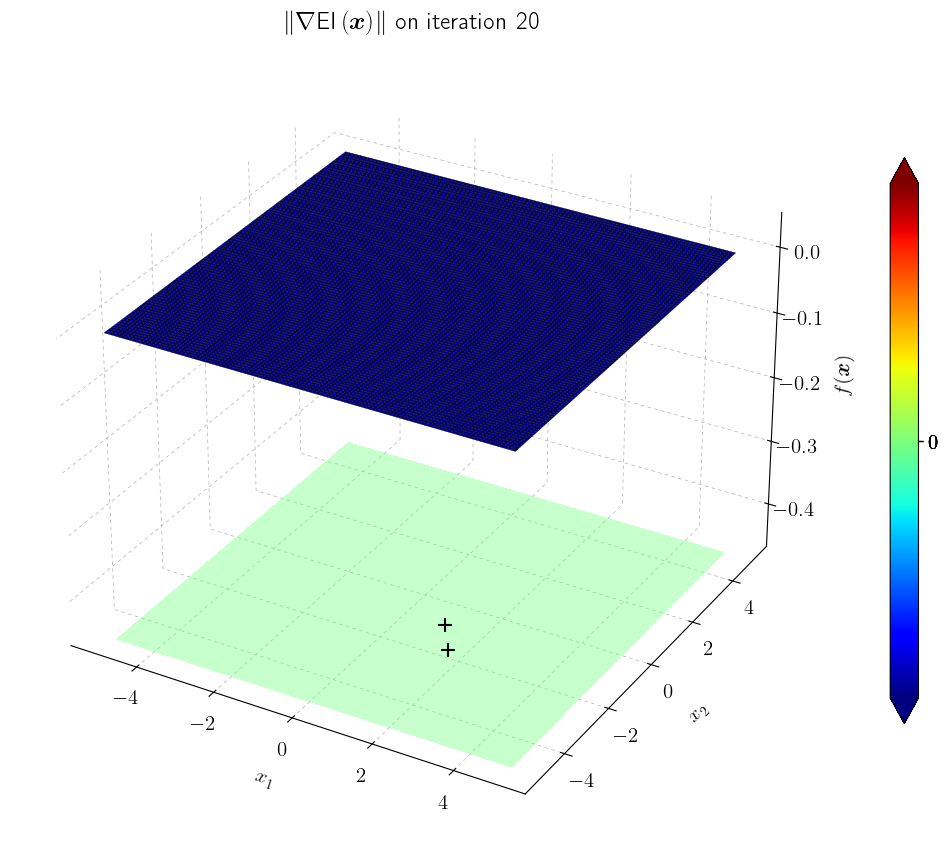

In [13]:
from importlib import reload

from ioh import ProblemClass, get_problem

import FewShotCVRP.bo_pure as bo_pure
import FewShotCVRP.utils.plots as myplots
from hillvallimpl import HillVallEAConfiguration, optimize

reload(bo_pure)

myplots.good_plt_config()

f = get_problem(22, instance=1, dimension=2, problem_class=ProblemClass.BBOB)

bo_iteration = 0


def acq_opt_callback(bo, X_optimized, X_cand, X_selected):
    global bo_iteration
    fig, ax = myplots.plot_3D_surface(
        (-5, 5),
        (-5, 5),
        bo._ei,
        X_selected,
        is_axis_names=True,
        is_white_facecolor=True,
        is_colorbar=True,
        discretization=100,
        zfactor=2.0,
        is_inverse=False,
        scatter_search_space_color="black",
    )
    bo_iteration += 1
    ax.set_title(r"$\text{EI}\br{\bm{x}}$" + f" on iteration {bo_iteration}")

    fig, ax = myplots.plot_3D_surface(
        (-5, 5),
        (-5, 5),
        lambda x: np.linalg.norm(bo._ei_with_grad(x)[1]),
        X_selected,
        is_axis_names=True,
        is_white_facecolor=True,
        is_colorbar=True,
        discretization=100,
        zfactor=2.0,
        is_inverse=False,
        scatter_search_space_color="black",
    )
    ax.set_title(r"$\norm{\nabla \text{EI}\br{\bm{x}}}$" + f" on iteration {bo_iteration}")



bo = bo_pure.BayesianOptimizer(
    f,
    f_batch=None,
    bounds=[(-5.0, 5.0), (-5.0, 5.0)],
    n_init=10,
    n_iter=20,
    sigma=0.001,
    # noise_std_guess=0.5,
    # noise_std_bounds=(0.1, 1.0),
    kernel="rbf",
    kernel_isotropic=True,
    length_scale_bounds=(0.1, 10.0),
    c_factor_bounds=(1 / 2, 2.0),
    suggestions_per_step=10,  # 3 diverse local maxima of EI per iteration
    diversity_frac=0.1,  # 10% of average box size as min separation
    random_state=1,
    acq_opt_callback=acq_opt_callback,
)
result = bo.run()
gp = bo.get_gp()
print("Best x:", result["x_obs_best"], "Best y:", result["y_obs_best"])
print(
    "Recommended x:",
    result["x_rec_mean_global"],
    "Best y:",
    result["x_rec_mean_global"],
)
print("Kernel:", gp.kernel_)
print("\nARD report:")
bo.report_ard()
# now = datetime.now()
# current_time = now.strftime("%Y-%m-%d-%Hh%Mm%Ss")
# bo.save_snapshot(f"../outputs/bo-experiments-{current_time}", result)

Selected 1 new points
Selected 3 new points
Selected 1 new points
Selected 1 new points
Selected 4 new points
Selected 3 new points
Selected 2 new points
Selected 3 new points
Selected 3 new points
Selected 3 new points
Selected 4 new points
Selected 4 new points
Selected 5 new points
Selected 2 new points
Selected 4 new points
Selected 2 new points
Selected 2 new points
Selected 5 new points
Selected 6 new points
Selected 5 new points
Best x: [ 2.30586481 -1.93188251] Best y: -999.206368874573
Recommended x: [ 2.15732589 -1.78372557] Best y: [ 2.15732589 -1.78372557]
Kernel: 1.14**2 * RBF(length_scale=0.897)

ARD report:
feature    length_scale        1/length
---------------------------------------
x0             0.896502         1.11545
x1             0.896502         1.11545


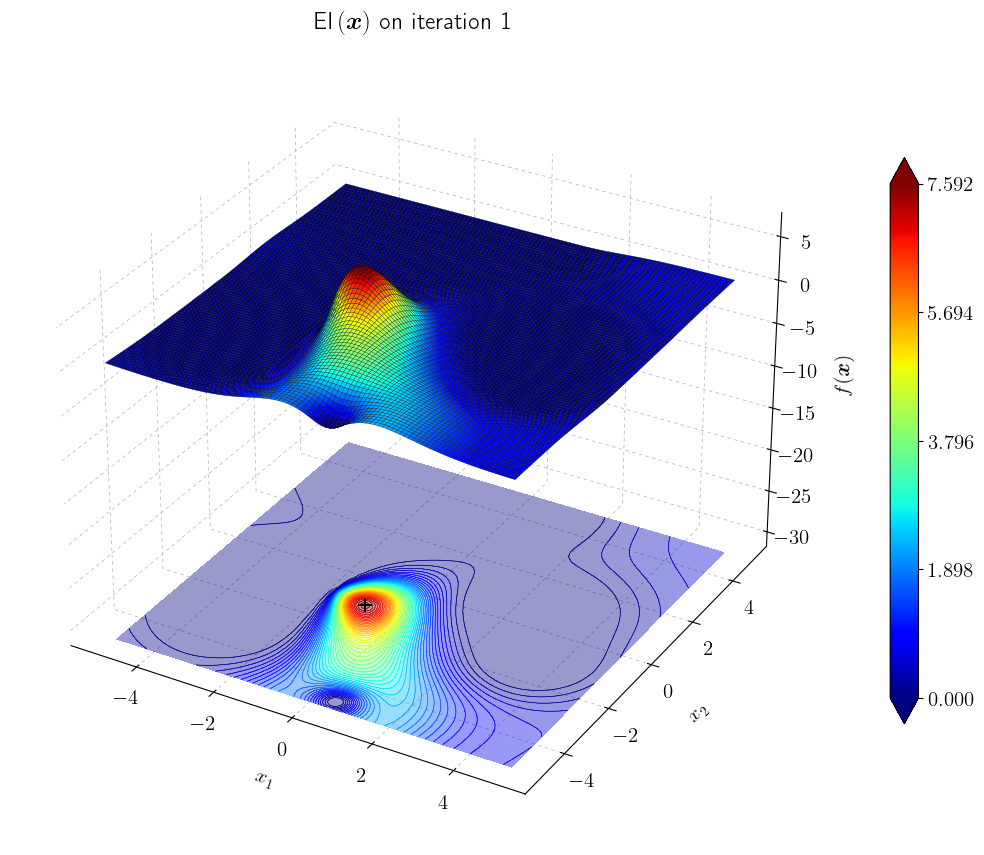

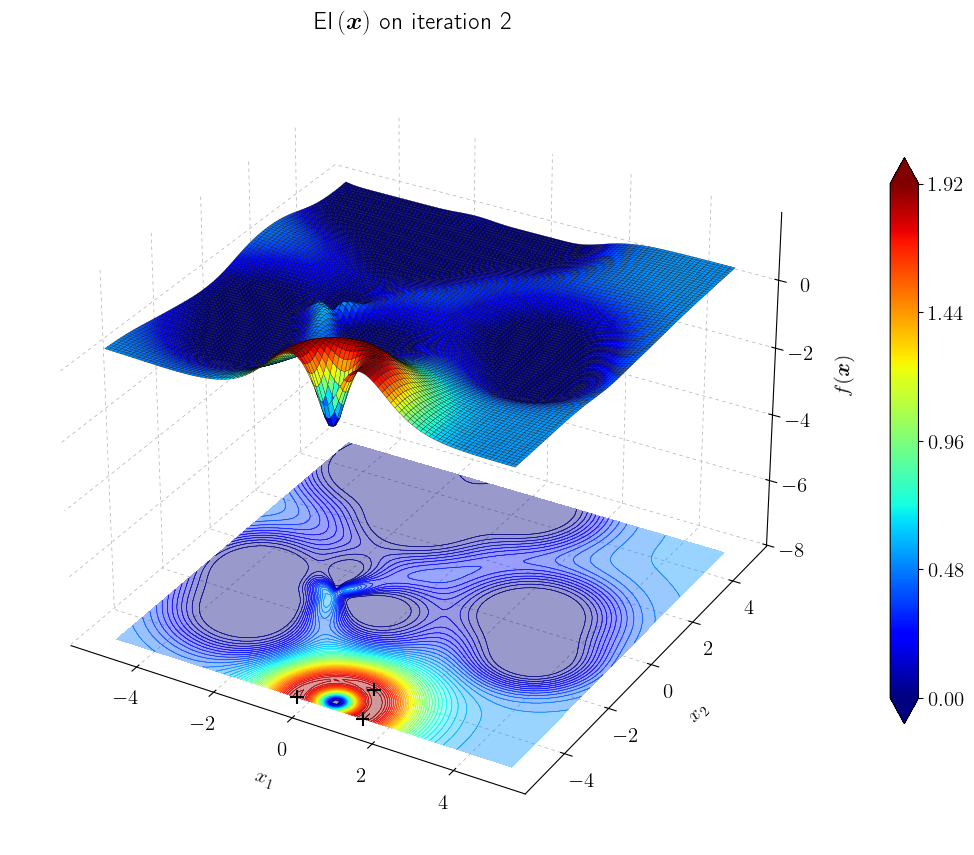

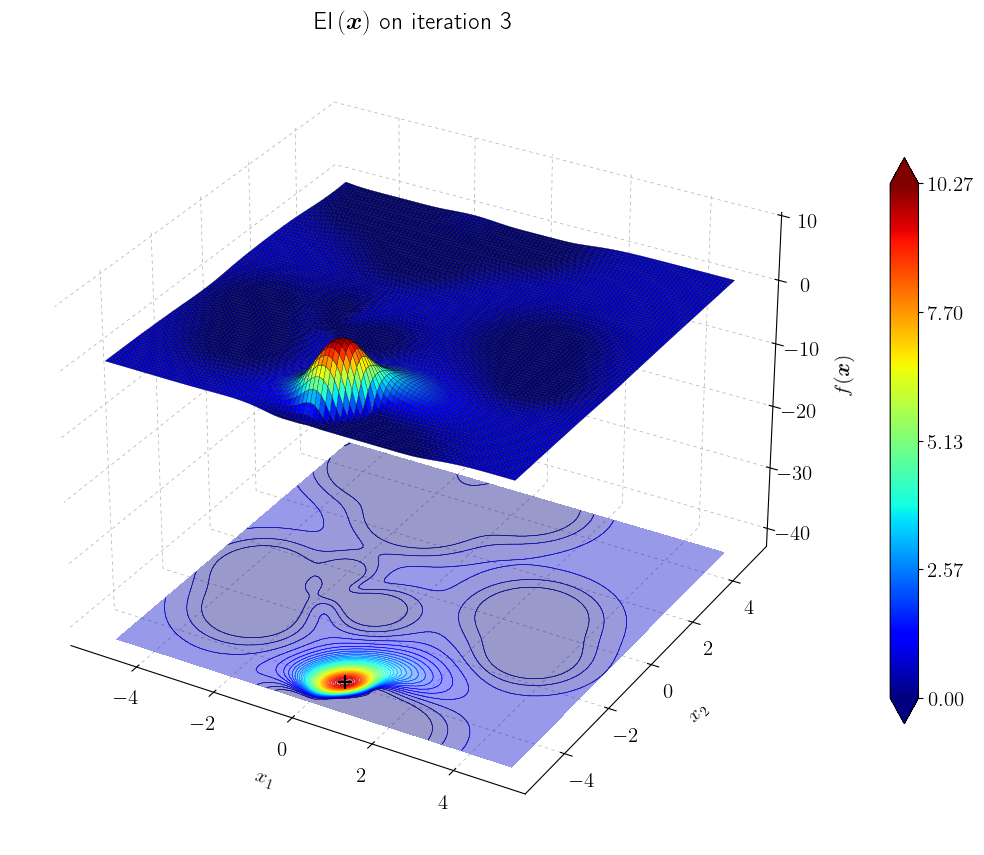

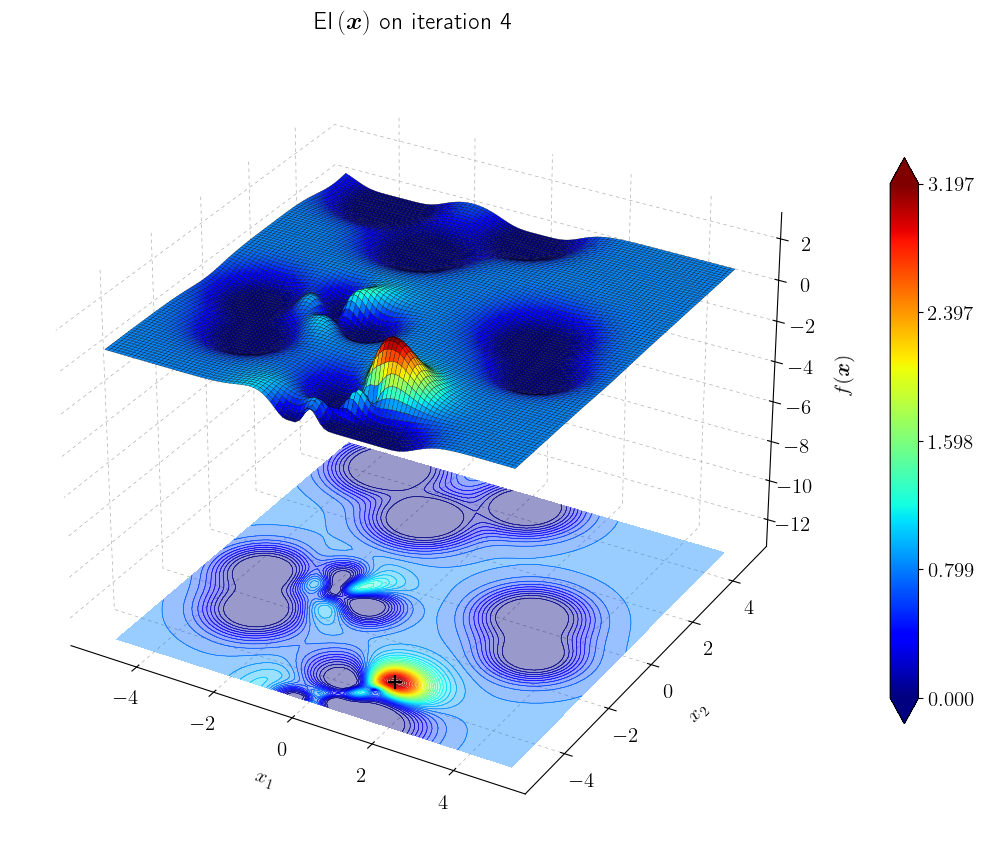

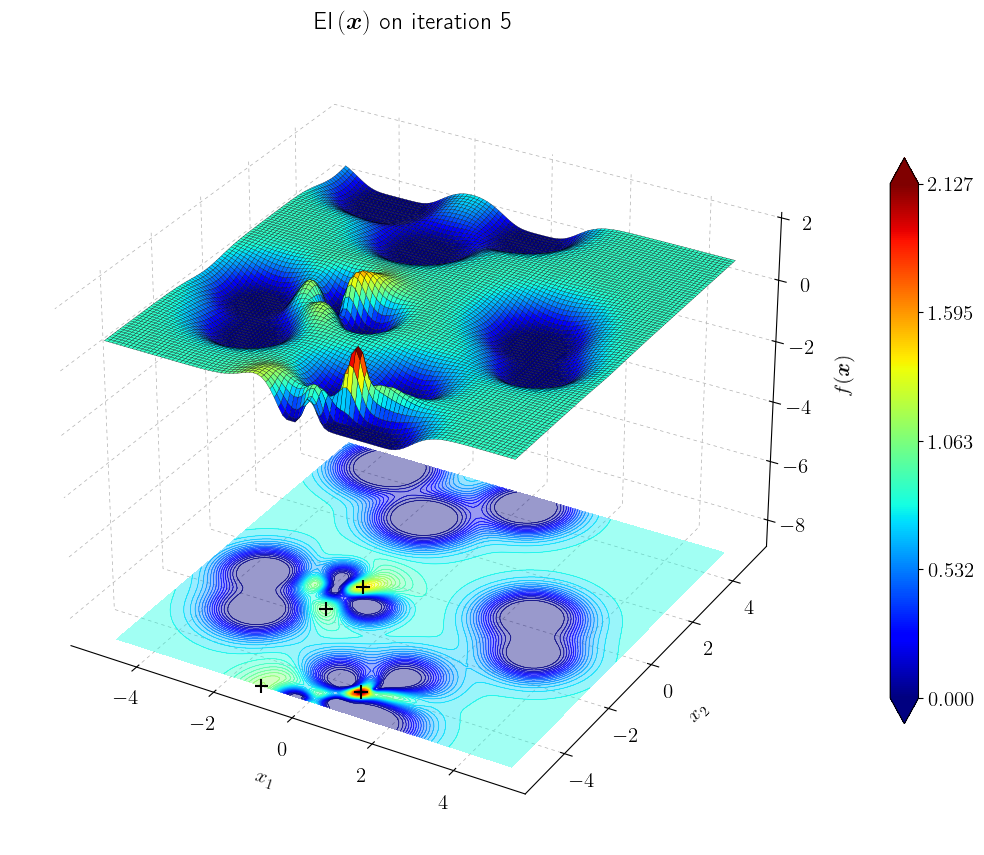

...

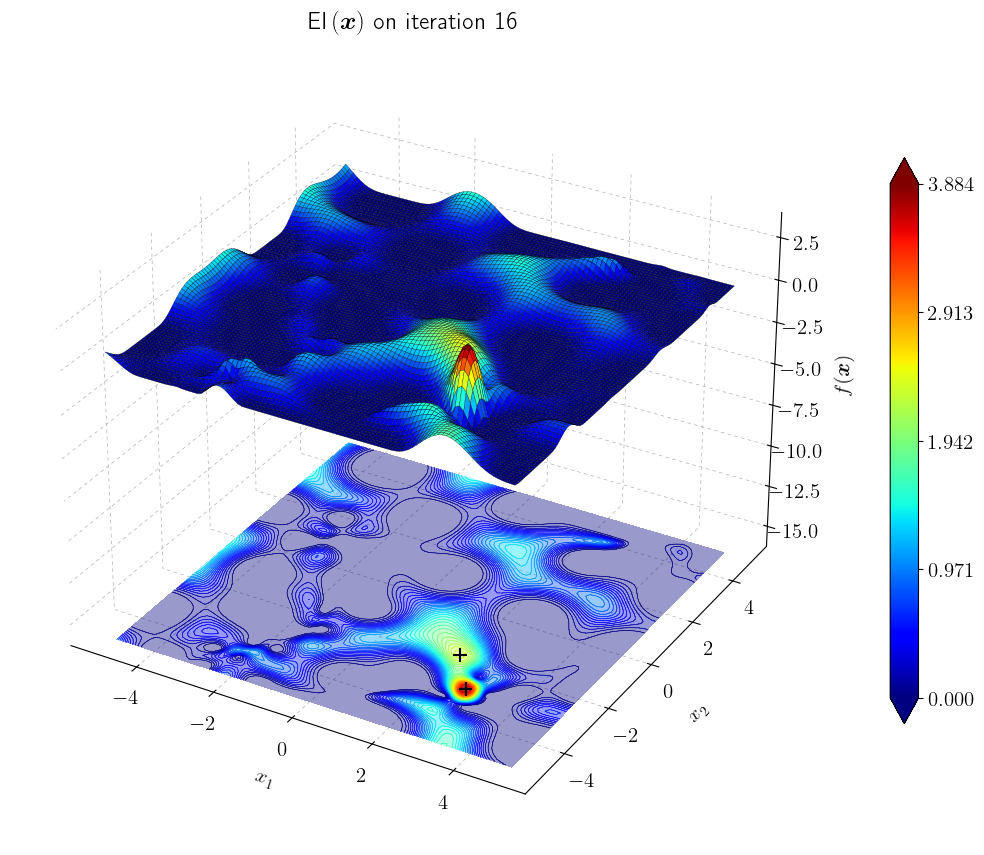

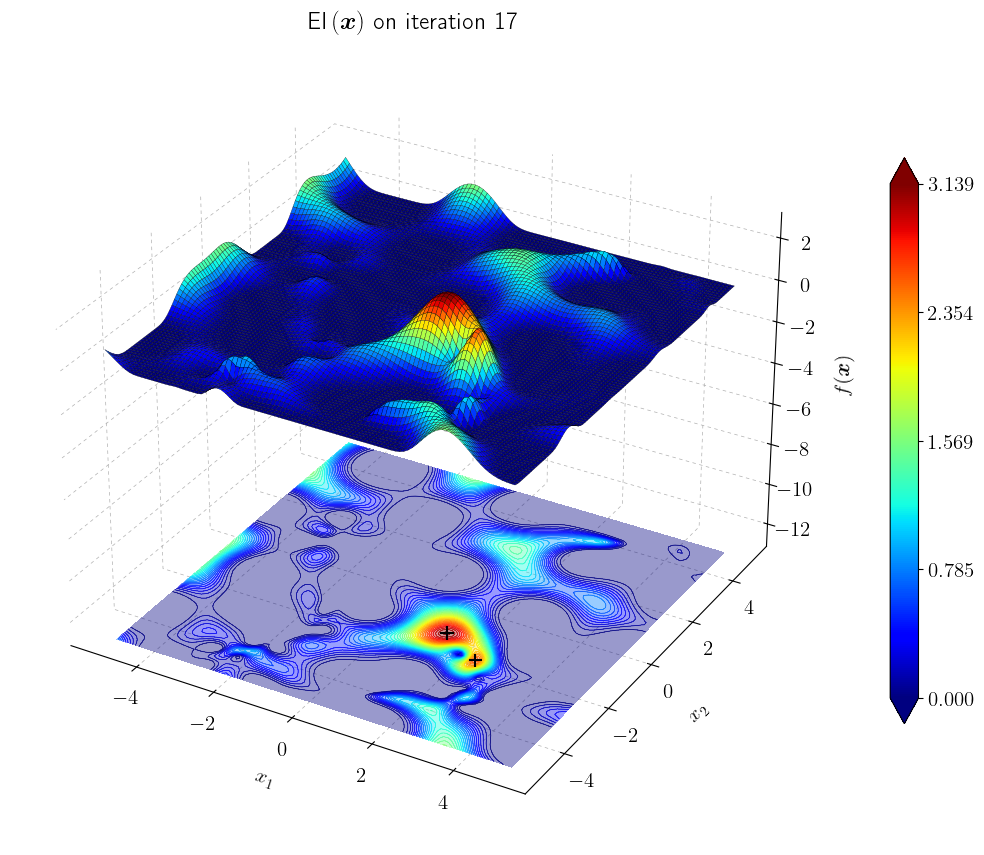

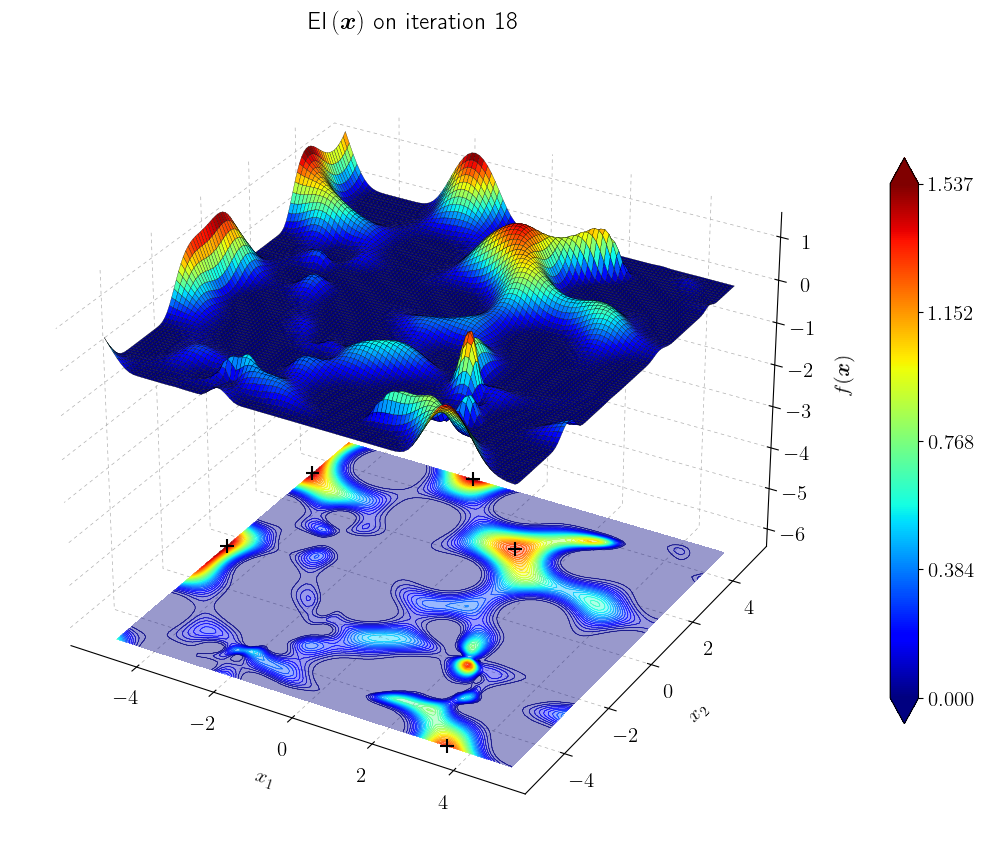

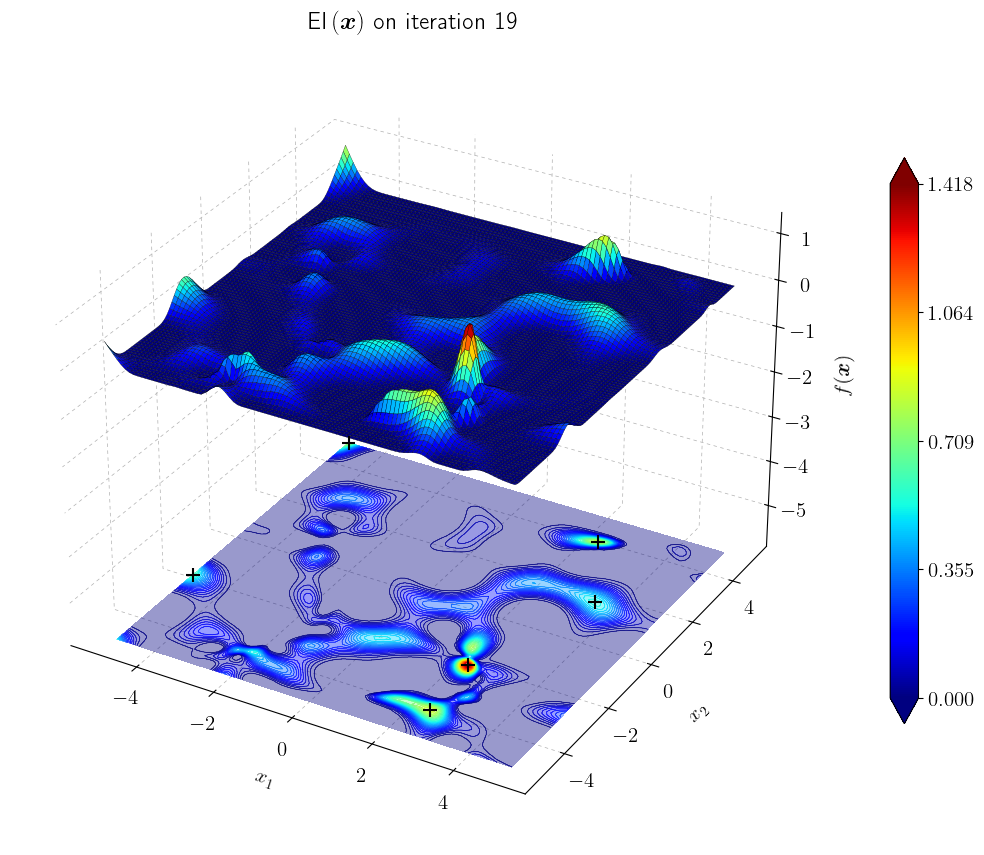

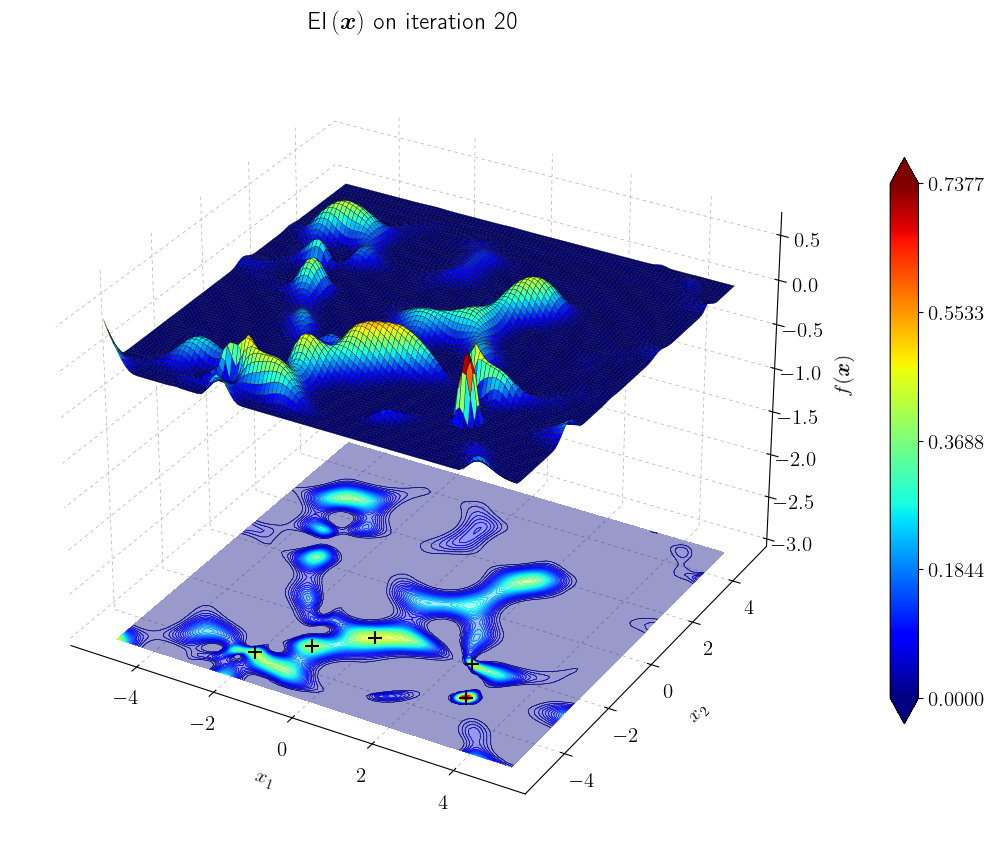

In [1]:
from importlib import reload

from ioh import ProblemClass, get_problem

import FewShotCVRP.bo_pure as bo_pure
import FewShotCVRP.utils.plots as myplots
from hillvallimpl import HillVallEAConfiguration, optimize

reload(bo_pure)

myplots.good_plt_config()

f = get_problem(22, instance=1, dimension=2, problem_class=ProblemClass.BBOB)

bo_iteration = 0


def acq_opt_callback(bo, X_optimized, X_cand, X_selected):
    global bo_iteration
    bo_iteration += 1

    fig, ax = myplots.plot_3D_surface(
        (-5, 5),
        (-5, 5),
        bo._ei,
        X_selected,
        is_axis_names=True,
        is_white_facecolor=True,
        is_colorbar=True,
        discretization=100,
        zfactor=2.0,
        is_inverse=False,
        scatter_search_space_color="black",
    )
    ax.set_title(r"$\text{EI}\br{\bm{x}}$" + f" on iteration {bo_iteration}")

    # fig, ax = myplots.plot_3D_surface(
    #     (-5, 5),
    #     (-5, 5),
    #     lambda x: np.linalg.norm(bo._ei_with_grad(x)[1]),
    #     X_selected,
    #     is_axis_names=True,
    #     is_white_facecolor=True,
    #     is_colorbar=True,
    #     discretization=100,
    #     zfactor=2.0,
    #     is_inverse=False,
    #     scatter_search_space_color="black",
    # )
    # ax.set_title(r"$\norm{\nabla \text{EI}\br{\bm{x}}}$" + f" on iteration {bo_iteration}")



bo = bo_pure.BayesianOptimizer(
    f,
    f_batch=None,
    bounds=[(-5.0, 5.0), (-5.0, 5.0)],
    n_init=10,
    n_iter=20,
    sigma=0.001,
    # noise_std_guess=0.5,
    # noise_std_bounds=(0.1, 1.0),
    kernel="rbf",
    kernel_isotropic=True,
    length_scale_bounds=(0.1, 10.0),
    c_factor_bounds=(1 / 2, 2.0),
    suggestions_per_step=10,  # 3 diverse local maxima of EI per iteration
    diversity_frac=0.1,  # 10% of average box size as min separation
    random_state=1,
    acq_opt_callback=acq_opt_callback,
)
result = bo.run()
gp = bo.get_gp()
print("Best x:", result["x_obs_best"], "Best y:", result["y_obs_best"])
print(
    "Recommended x:",
    result["x_rec_mean_global"],
    "Best y:",
    result["x_rec_mean_global"],
)
print("Kernel:", gp.kernel_)
print("\nARD report:")
bo.report_ard()
# now = datetime.now()
# current_time = now.strftime("%Y-%m-%d-%Hh%Mm%Ss")
# bo.save_snapshot(f"../outputs/bo-experiments-{current_time}", result)

Running HillVallEA on the defined objective function
Selected 4 new points
Running HillVallEA on the defined objective function
Selected 7 new points
Running HillVallEA on the defined objective function
Selected 8 new points
Running HillVallEA on the defined objective function
Selected 10 new points
Running HillVallEA on the defined objective function
Selected 10 new points
Running HillVallEA on the defined objective function
Selected 10 new points
Running HillVallEA on the defined objective function
Selected 10 new points
Running HillVallEA on the defined objective function
Selected 10 new points
Running HillVallEA on the defined objective function
Selected 10 new points
Running HillVallEA on the defined objective function
Selected 10 new points
Running HillVallEA on the defined objective function
Selected 10 new points
Running HillVallEA on the defined objective function
Selected 10 new points
Running HillVallEA on the defined objective function
Selected 10 new points
Running HillVal

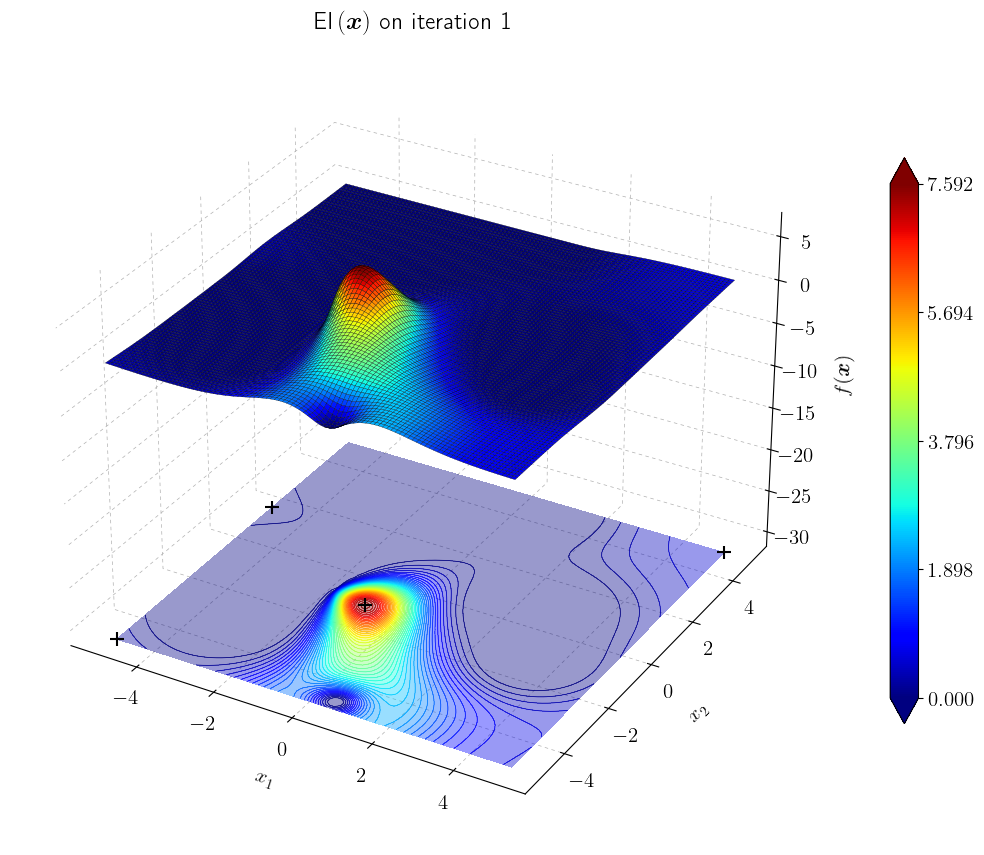

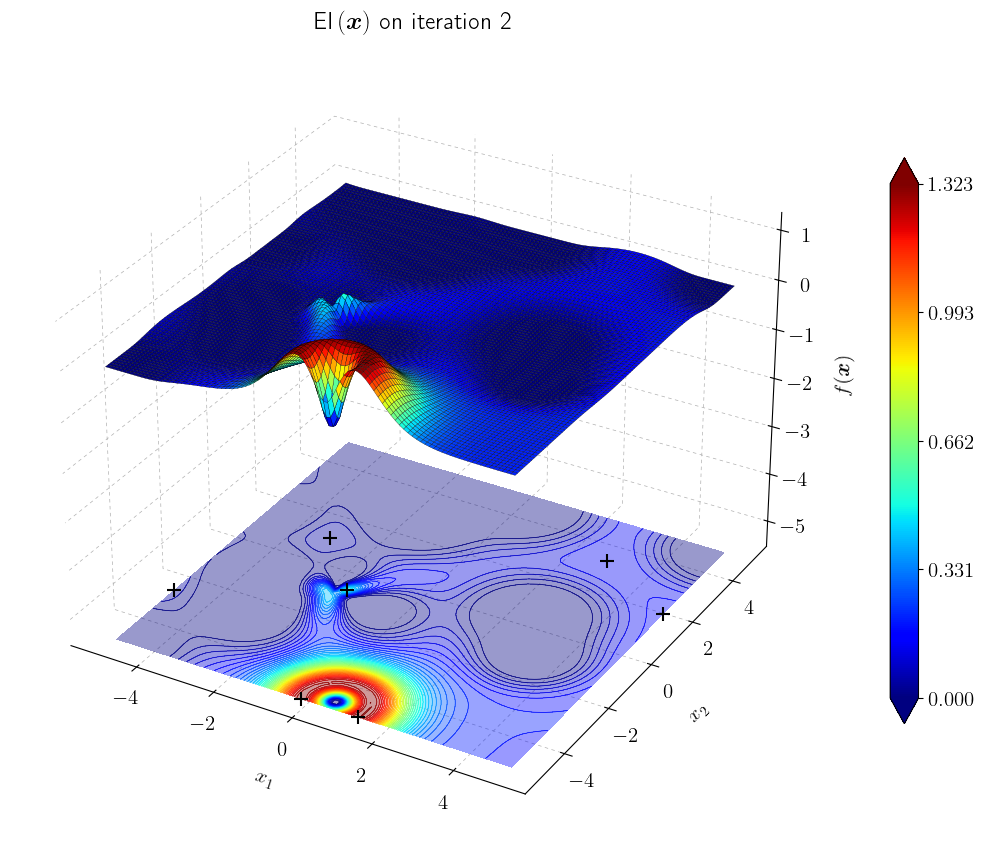

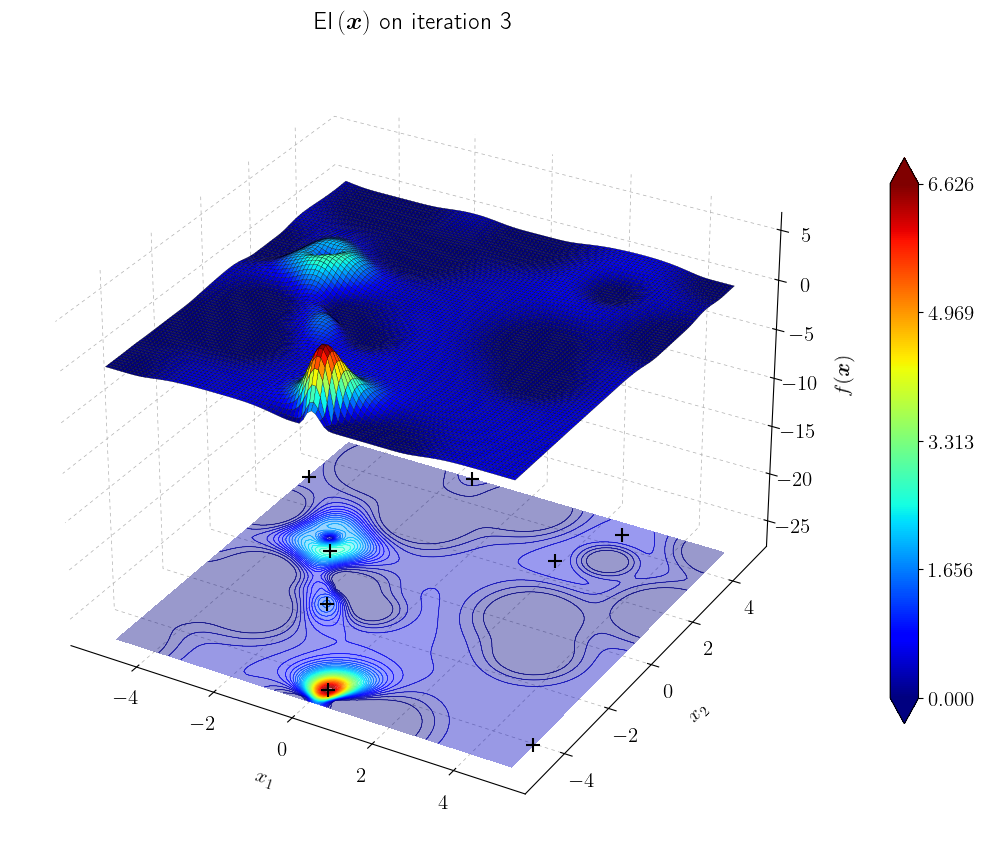

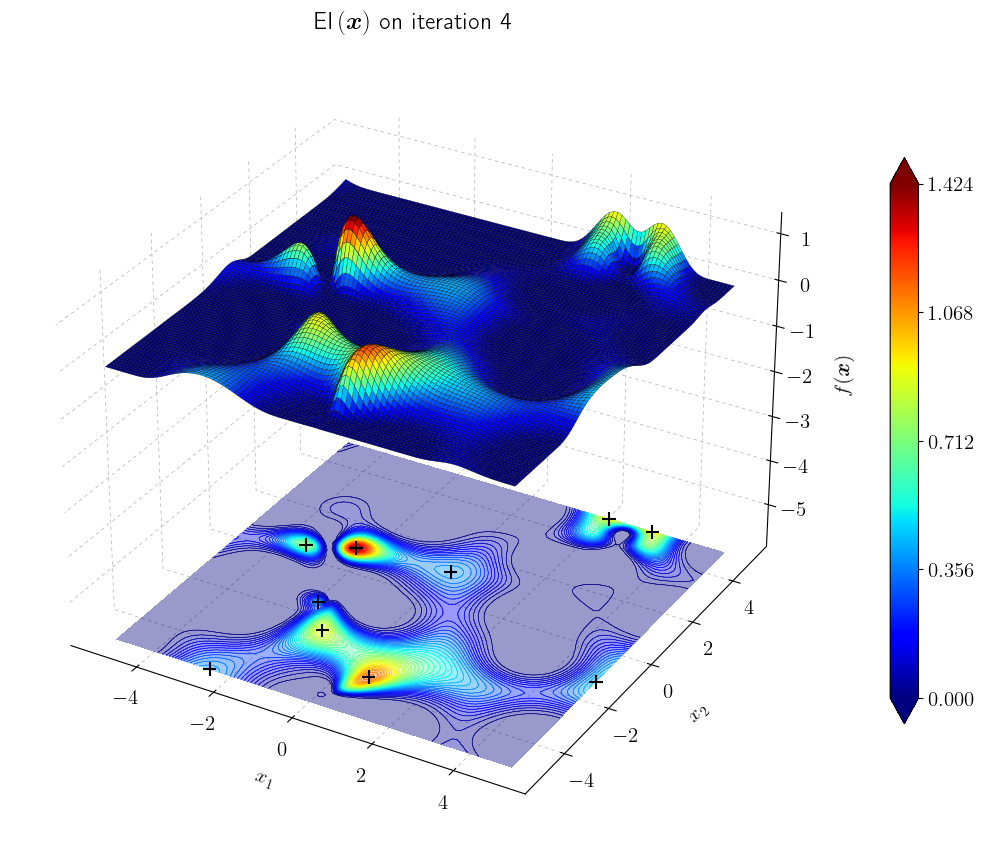

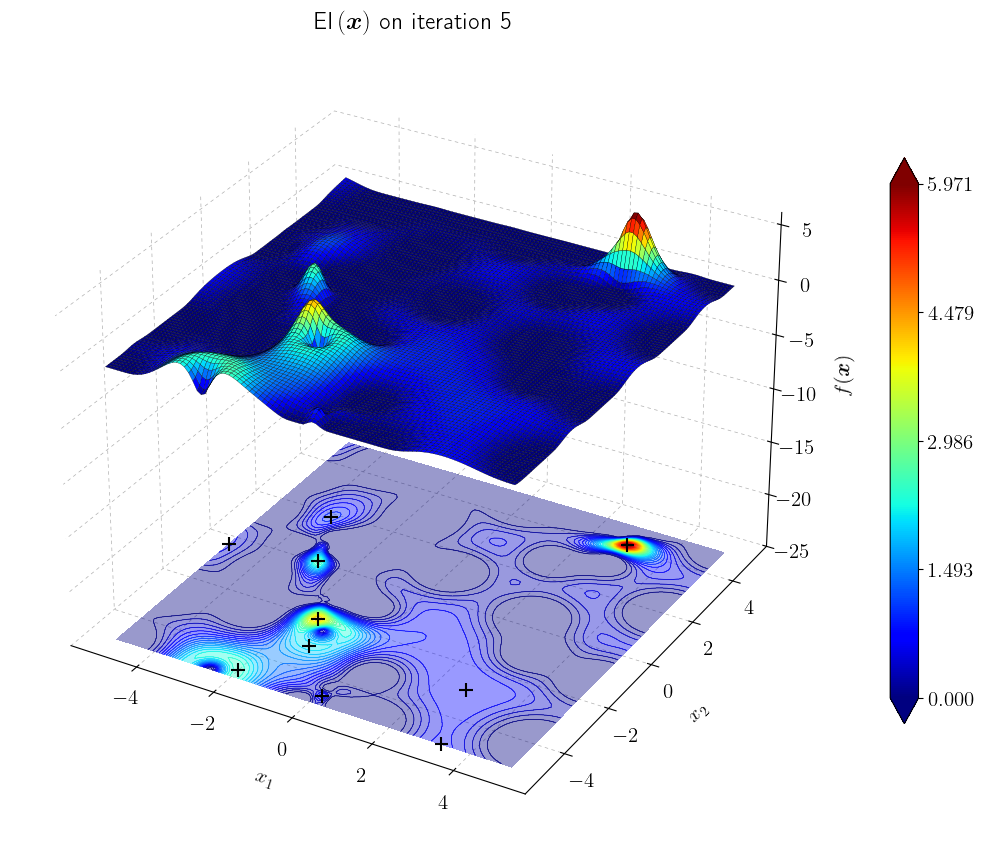

...

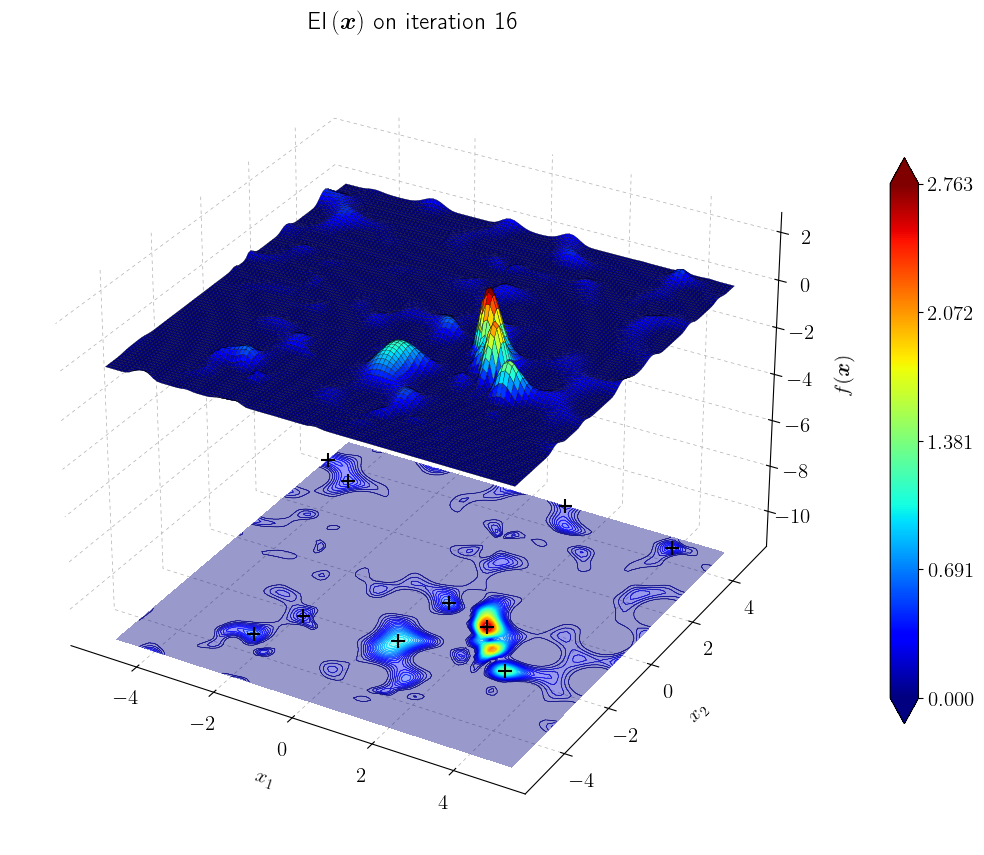

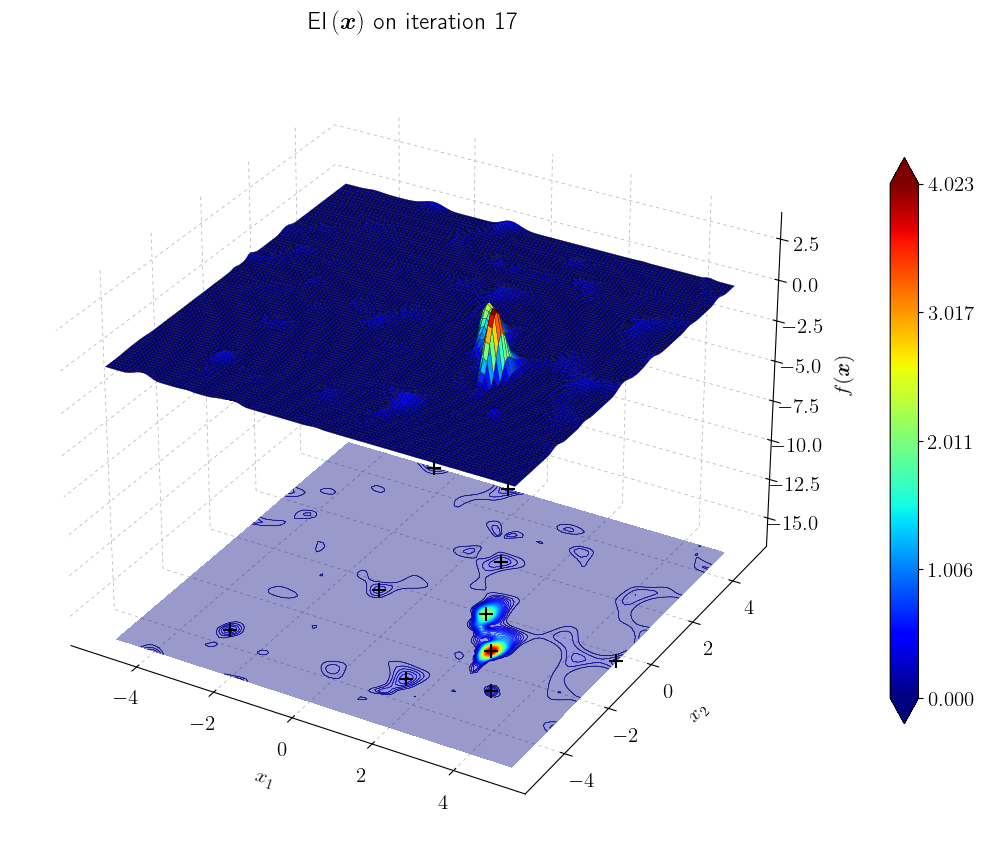

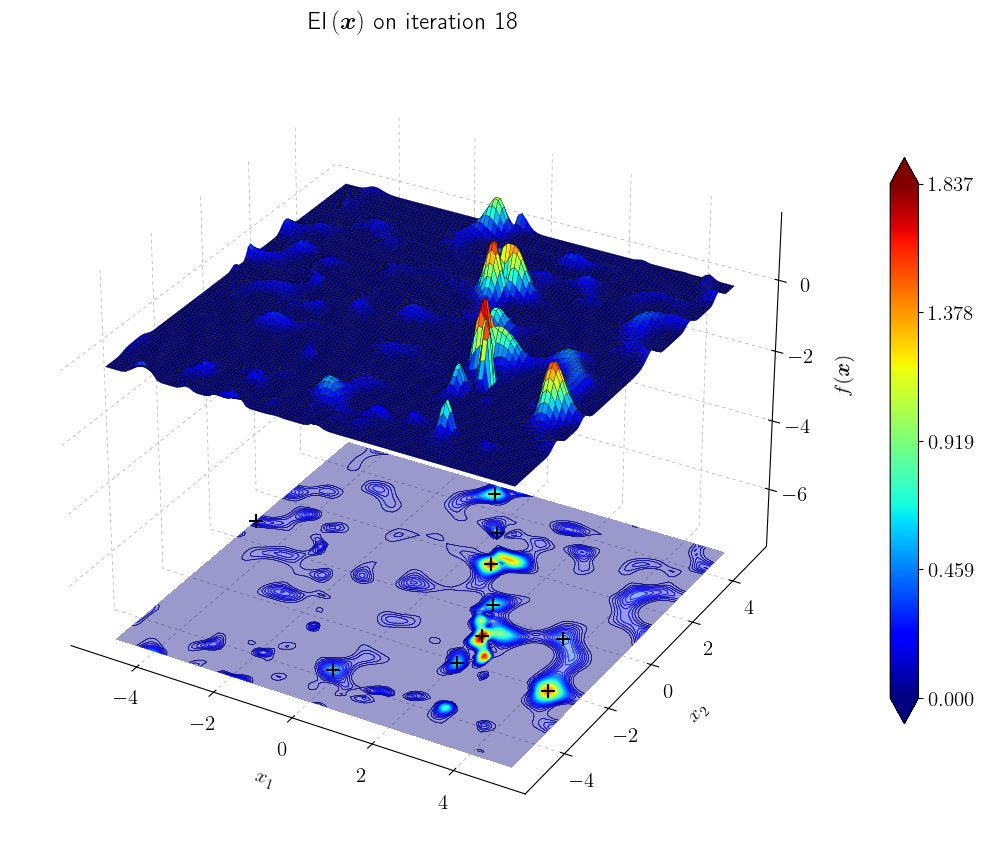

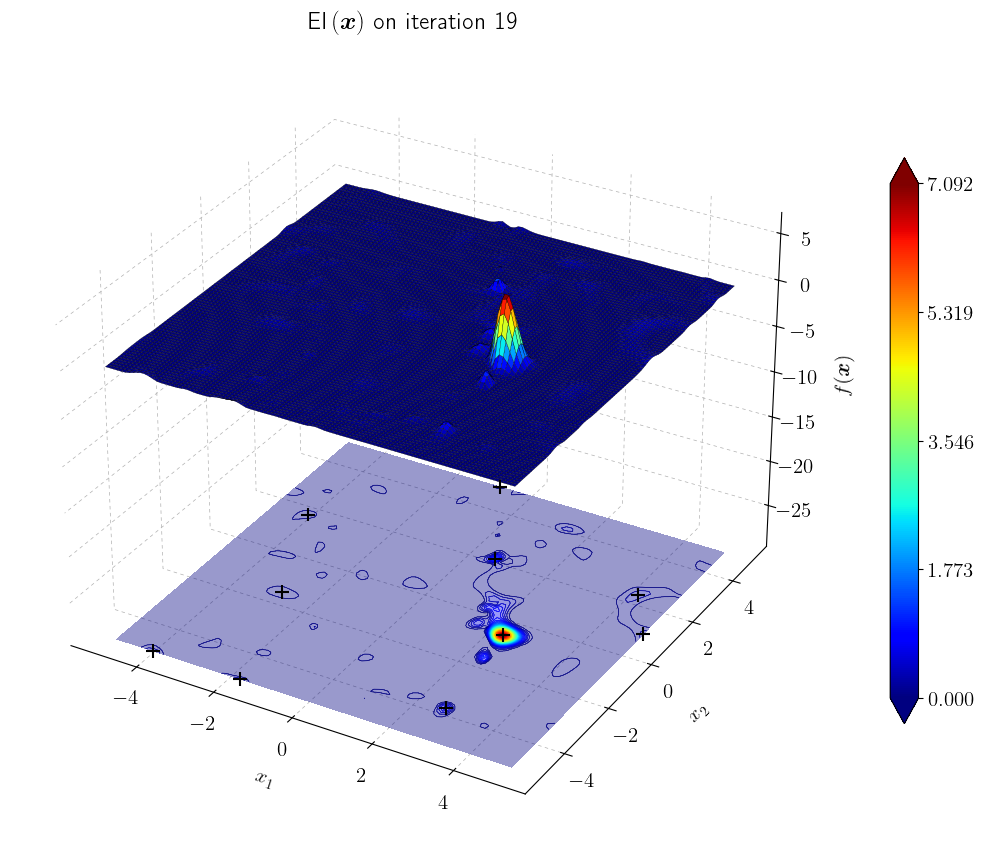

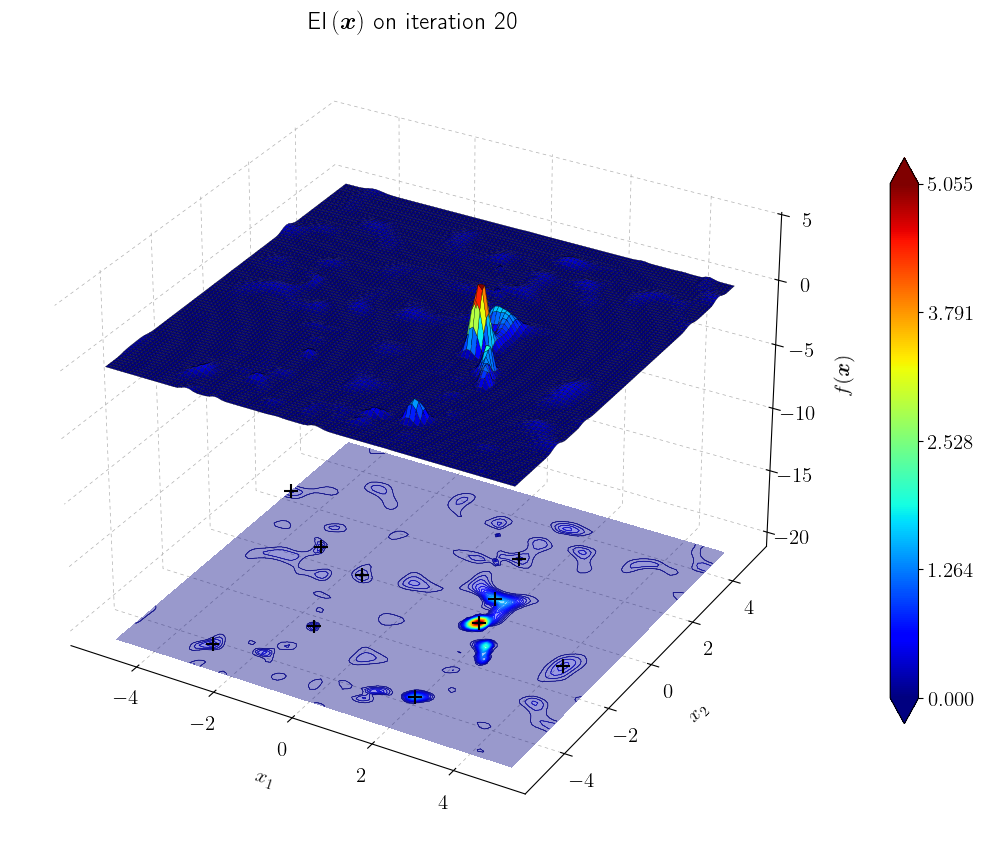

In [3]:
from importlib import reload

from ioh import ProblemClass, get_problem

import FewShotCVRP.bo.bo_ei_hvea as bo_ei_hvea
import FewShotCVRP.utils.plots as myplots
from hillvallimpl import HillVallEAConfiguration, optimize

reload(bo_ei_hvea)

myplots.good_plt_config()

f = get_problem(22, instance=1, dimension=2, problem_class=ProblemClass.BBOB)

bo_iteration = 0


def acq_opt_callback(bo, X_optimized, X_cand, X_selected):
    global bo_iteration
    bo_iteration += 1

    fig, ax = myplots.plot_3D_surface(
        (-5, 5),
        (-5, 5),
        bo._ei,
        X_selected,
        is_axis_names=True,
        is_white_facecolor=True,
        is_colorbar=True,
        discretization=100,
        zfactor=2.0,
        is_inverse=False,
        scatter_search_space_color="black",
    )
    ax.set_title(r"$\text{EI}\br{\bm{x}}$" + f" on iteration {bo_iteration}")

    # fig, ax = myplots.plot_3D_surface(
    #     (-5, 5),
    #     (-5, 5),
    #     lambda x: np.linalg.norm(bo._ei_with_grad(x)[1]),
    #     X_selected,
    #     is_axis_names=True,
    #     is_white_facecolor=True,
    #     is_colorbar=True,
    #     discretization=100,
    #     zfactor=2.0,
    #     is_inverse=False,
    #     scatter_search_space_color="black",
    # )
    # ax.set_title(r"$\norm{\nabla \text{EI}\br{\bm{x}}}$" + f" on iteration {bo_iteration}")



bo = bo_ei_hvea.BayesianOptimizerEIHVEA(
    f,
    f_batch=None,
    bounds=[(-5.0, 5.0), (-5.0, 5.0)],
    n_init=10,
    n_iter=20,
    sigma=0.001,
    # noise_std_guess=0.5,
    # noise_std_bounds=(0.1, 1.0),
    kernel="rbf",
    kernel_isotropic=True,
    length_scale_bounds=(0.1, 10.0),
    c_factor_bounds=(1 / 2, 2.0),
    suggestions_per_step=10,  # 3 diverse local maxima of EI per iteration
    diversity_frac=0.1,  # 10% of average box size as min separation
    random_state=1,
    acq_opt_callback=acq_opt_callback,
)
result = bo.run()
gp = bo.get_gp()
print("Best x:", result["x_obs_best"], "Best y:", result["y_obs_best"])
print(
    "Recommended x:",
    result["x_rec_mean_global"],
    "Best y:",
    result["x_rec_mean_global"],
)
print("Kernel:", gp.kernel_)
print("\nARD report:")
bo.report_ard()
# now = datetime.now()
# current_time = now.strftime("%Y-%m-%d-%Hh%Mm%Ss")
# bo.save_snapshot(f"../outputs/bo-experiments-{current_time}", result)

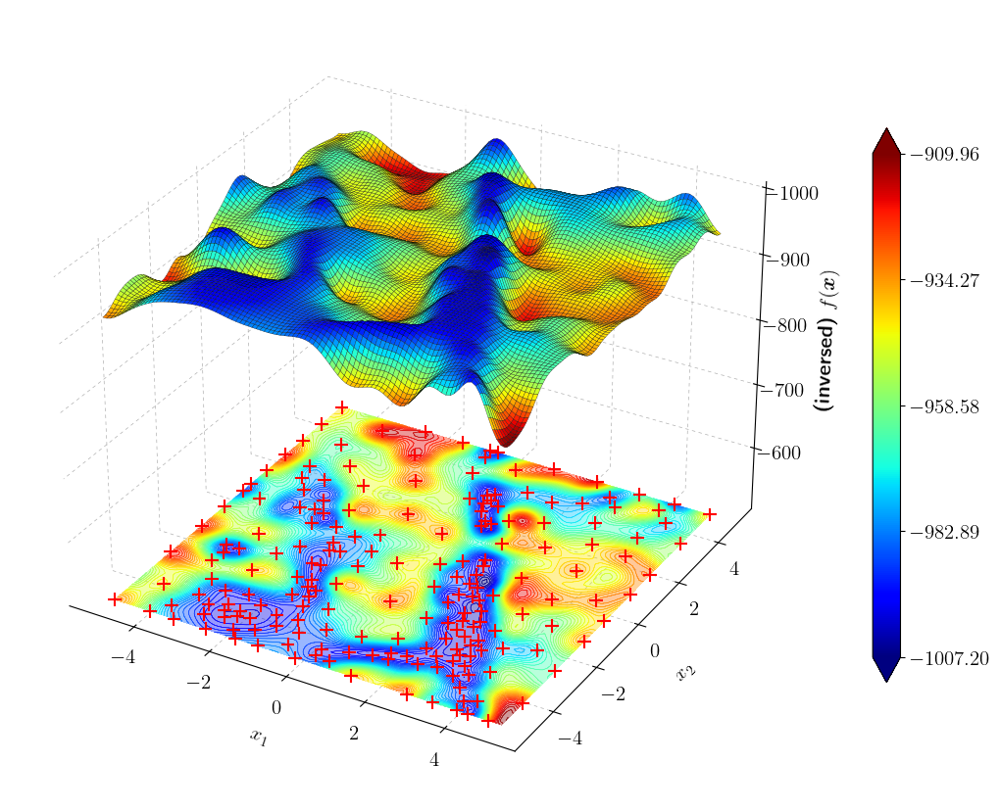

In [5]:
fig, ax = myplots.plot_3D_surface(
    (-5, 5),
    (-5, 5),
    lambda x: gp.predict([x], return_std=False)[0],
    bo.X_,
    is_axis_names=True,
    is_white_facecolor=True,
    is_colorbar=True,
    discretization=100,
    zfactor=2.0,
    is_inverse=True,
)

In [6]:
len(bo.X_)

199

In [7]:
# pip install cma

import cma
import numpy as np
from cma.boundary_handler import BoundTransform
from cma.options_parameters import CMAOptions

dim = 2
sigma0 = 1.0
tolx = 1e-10
tolfun = 1e-10
tolfunhist = 1e-5
verb_disp = 0
verb_log = 0
seed = 42
maxevals = 199

rng = np.random.default_rng(seed)
lo, up = np.ones(dim) * -5, np.ones(dim) * 5
x0 = rng.uniform(low=lo, high=up, size=dim)
base_opts = {
    "integer_variables": None,
    "BoundaryHandler": BoundTransform,
    "bounds": [np.array(lo), np.array(up)],
    "maxfevals": maxevals,
    "tolx": tolx,
    "tolfun": tolfun,
    "tolfunhist": tolfunhist,
    "verb_disp": verb_disp,
    "verb_log": verb_log,
    "seed": seed,
}

opts = CMAOptions(base_opts)

cma_history = []


def f_(x):
    cma_history.append(x)
    return f(x)


# Construct and run
es = cma.CMAEvolutionStrategy(x0, sigma0, opts)
res = es.optimize(f_).result

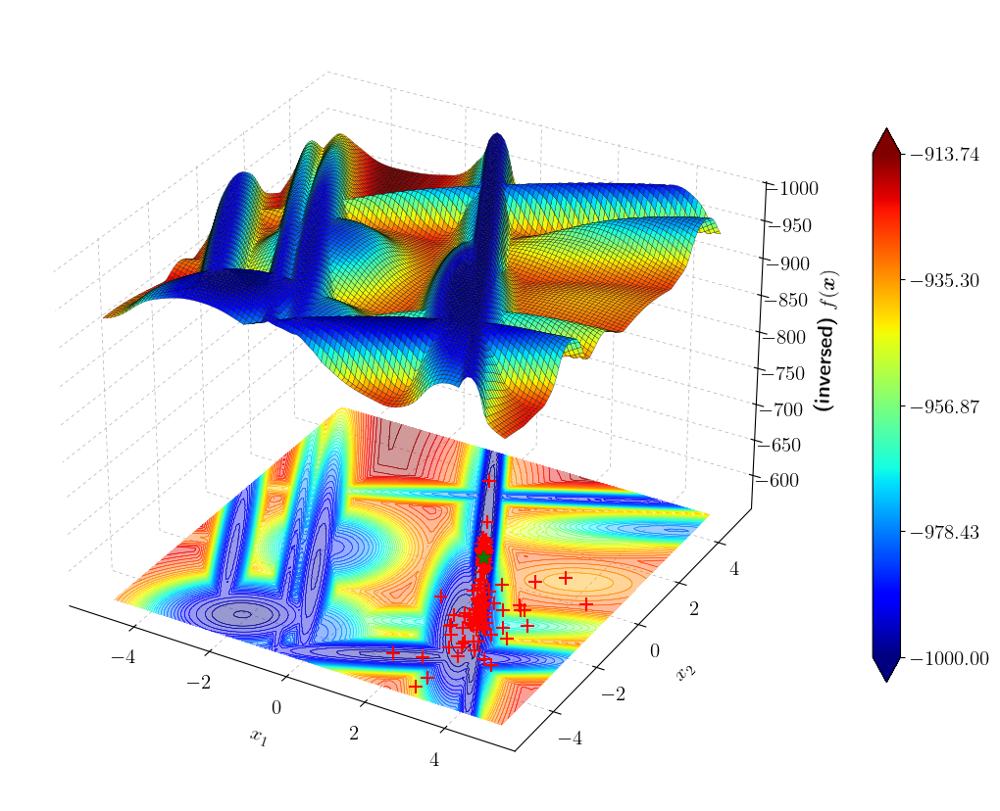

In [8]:
fig, ax = myplots.plot_3D_surface(
    (-5, 5),
    (-5, 5),
    f,
    np.array(cma_history),
    is_axis_names=True,
    is_white_facecolor=True,
    is_colorbar=True,
    discretization=100,
    zfactor=2.0,
    is_inverse=True,
)

zax_min, zax_max = ax.get_zlim()
ax.scatter(
    res.xbest[0],
    res.xbest[1],
    zax_min,
    c="black",
    marker="*",
    s=100,
    alpha=1,
    zorder=4,
)
ax.scatter(
    res.xfavorite[0],
    res.xfavorite[1],
    zax_min,
    c="green",
    marker="*",
    s=100,
    alpha=1,
    zorder=4,
)